# Subway Restaurant

## Every Subway Restaurant Location in the US
## Restaurant Locations of all Subway Restaurants in the US..


### About this dataset
- Subway Restaurant Location Data
- Subway is an American privately held restaurant franchise that primarily sells submarine sandwiches and salads. It is one of the fastest-growing franchises in the world and, as of October 2019, had 41,512 locations in more than 100 countries.

- This is a complete list of all Subway restaurant locations, along with their geographic coordinates, Street addresses, City, State, ZIP code, opening hours etc in the US.

## Data Exploration

In [1]:
#Importing the basic librarires

import numpy as np
import pandas as pd
import seaborn as sns
import datetime as dt
import matplotlib.pyplot as plt
%matplotlib inline
import folium
from wordcloud import WordCloud, STOPWORDS

In [2]:
#Importing the dataset

df=pd.read_csv("../input/subway-restaurant-location-datasete/subway_2018_11_06.csv")

In [3]:
# looking the data set
df.head()

,name,url,street_address,city,state,zip_code,country,phone_number_1,phone_number_2,fax_1,...,email_2,website,open_hours,latitude,longitude,facebook,twitter,instagram,pinterest,youtube
0,Subway,http://order.subway.com/Stores/Redirect.aspx?s...,"1800 Duke St, Ste 100",Alexandria,VA,22314,USA,NaN,NaN,NaN,...,NaN,NaN,"Monday 7:00 AM - 7:00 PM, Tuesday 7:00 AM - 7:...",38.8043,-77.0611,NaN,NaN,NaN,NaN,NaN
1,Subway,http://order.subway.com/Stores/Redirect.aspx?s...,"1512 King St,",Alexandria,VA,22301,USA,NaN,NaN,NaN,...,NaN,NaN,"Sunday 9:00 AM - 8:00 PM, Monday 7:00 AM - 9:0...",38.8062,-77.0565,NaN,NaN,NaN,NaN,NaN
2,Subway,http://order.subway.com/Stores/Redirect.aspx?s...,"2361 Eisenhower Ave,",Alexandria,VA,22314,USA,NaN,NaN,NaN,...,NaN,NaN,"Sunday 9:00 AM - 8:30 PM, Monday 6:30 AM - 9:0...",38.8012,-77.0691,NaN,NaN,NaN,NaN,NaN
3,Subway,http://order.subway.com/Stores/Redirect.aspx?s...,"320 King Street, 1st Floor",Alexandria,VA,22314,USA,NaN,NaN,NaN,...,NaN,NaN,"Sunday 9:00 AM - 8:00 PM, Monday 7:00 AM - 9:0...",38.8045,-77.0433,NaN,NaN,NaN,NaN,NaN
4,Subway,http://order.subway.com/Stores/Redirect.aspx?s...,"5836 N. Kings Hwy, Suite A, Huntington Station",Alexandria,VA,22303,USA,NaN,NaN,NaN,...,NaN,NaN,"Sunday 9:00 AM - 9:00 PM, Monday 7:00 AM - 10:...",38.7903,-77.0769,NaN,NaN,NaN,NaN,NaN


In [4]:
# print the shape dataset
print("Shape The DataSet ", df.shape )

Shape The DataSet  (25533, 22)


In [5]:
#Checking the dtypes of all the columns

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25533 entries, 0 to 25532
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            25533 non-null  object 
 1   url             24017 non-null  object 
 2   street_address  25533 non-null  object 
 3   city            25533 non-null  object 
 4   state           25533 non-null  object 
 5   zip_code        25533 non-null  object 
 6   country         25533 non-null  object 
 7   phone_number_1  0 non-null      float64
 8   phone_number_2  0 non-null      float64
 9   fax_1           0 non-null      float64
 10  fax_2           0 non-null      float64
 11  email_1         0 non-null      float64
 12  email_2         0 non-null      float64
 13  website         0 non-null      float64
 14  open_hours      25395 non-null  object 
 15  latitude        25533 non-null  float64
 16  longitude       25533 non-null  float64
 17  facebook        0 non-null     

In [6]:
#checking null value 
df.isna().sum()

name                  0
url                1516
street_address        0
city                  0
state                 0
zip_code              0
country               0
phone_number_1    25533
phone_number_2    25533
fax_1             25533
fax_2             25533
email_1           25533
email_2           25533
website           25533
open_hours          138
latitude              0
longitude             0
facebook          25533
twitter           25533
instagram         25533
pinterest         25533
youtube           25533
dtype: int64

## We have a lot of missing data , also I don`t need all this columns 

- I need columes - [ ["street_address","state","city","open_hours","latitude","longitude"]

In [7]:
# Create new data with columns needed

data=df[["street_address","state","city","open_hours","latitude","longitude"]]

In [8]:
data.head()

,street_address,state,city,open_hours,latitude,longitude
0,"1800 Duke St, Ste 100",VA,Alexandria,"Monday 7:00 AM - 7:00 PM, Tuesday 7:00 AM - 7:...",38.8043,-77.0611
1,"1512 King St,",VA,Alexandria,"Sunday 9:00 AM - 8:00 PM, Monday 7:00 AM - 9:0...",38.8062,-77.0565
2,"2361 Eisenhower Ave,",VA,Alexandria,"Sunday 9:00 AM - 8:30 PM, Monday 6:30 AM - 9:0...",38.8012,-77.0691
3,"320 King Street, 1st Floor",VA,Alexandria,"Sunday 9:00 AM - 8:00 PM, Monday 7:00 AM - 9:0...",38.8045,-77.0433
4,"5836 N. Kings Hwy, Suite A, Huntington Station",VA,Alexandria,"Sunday 9:00 AM - 9:00 PM, Monday 7:00 AM - 10:...",38.7903,-77.0769


In [9]:
data.isna().sum()

street_address      0
state               0
city                0
open_hours        138
latitude            0
longitude           0
dtype: int64

In [10]:
# Counts the State 

C_state = data["state"].value_counts()
C_state

CA    2590
TX    2194
FL    1490
OH    1171
IL    1110
NY    1066
MI     930
PA     865
GA     852
NC     828
VA     683
IN     653
TN     628
WA     591
WI     579
MO     547
MN     491
LA     472
MD     471
AL     456
AZ     453
CO     437
KY     416
SC     410
OK     400
MA     380
CT     369
MS     310
IA     305
OR     304
NJ     284
AR     283
KS     260
NV     218
UT     218
NE     206
WV     185
PR     178
NM     176
ID     133
ME     117
HI     115
SD      98
NH      98
MT      84
RI      80
DC      69
ND      67
WY      67
AK      63
VT      49
DE      34
Name: state, dtype: int64

<AxesSubplot:>

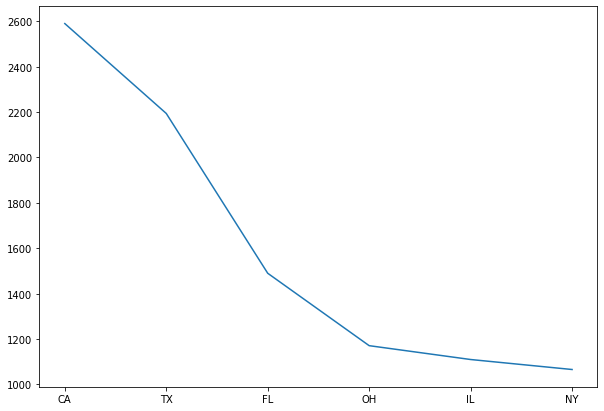

In [11]:

C_state.head(6).plot(figsize=(10,7))

 ## The highest number of branches at this state [ CA , TX , FL , OH , IL  , NY  ]


/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


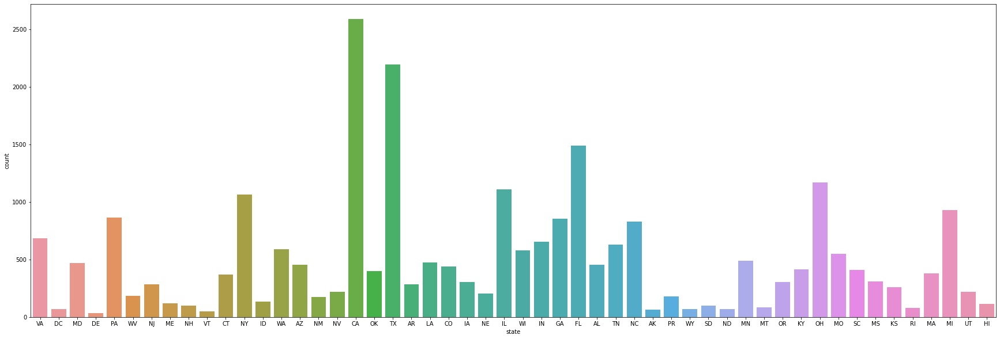

In [12]:
# let`s see all number of branches at all USA 

plt.figure(figsize=(30,10))
sns.countplot(data["state"])
plt.show()

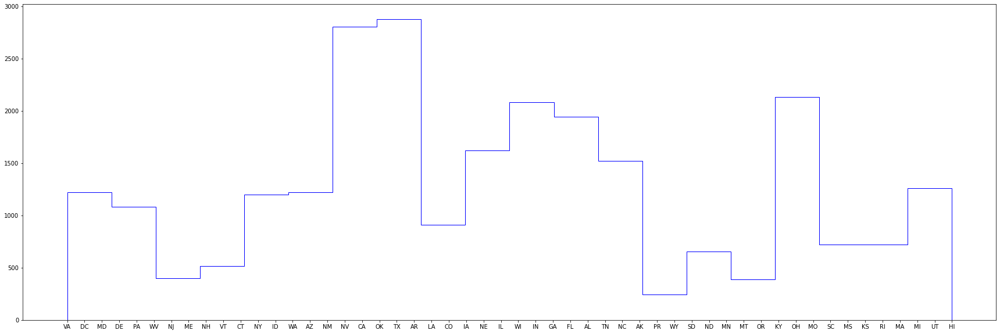

In [13]:
# Show using hist
plt.figure(figsize=(30,10))
plt.hist(data=data ,x="state",bins=20,histtype="step",color="b")
plt.show()

<AxesSubplot:>

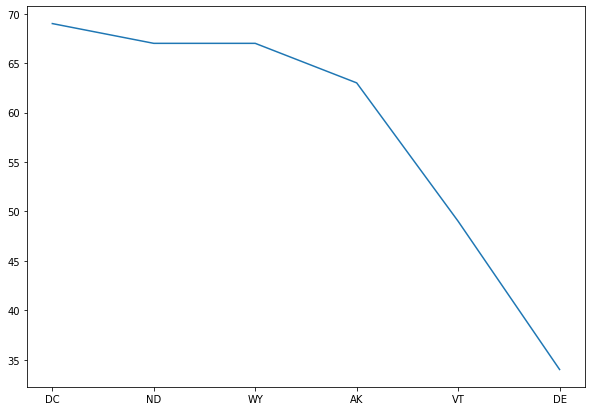

In [14]:
C_state.tail(6).plot(figsize=(10,7))

## The less number of branches at this state [ DC , ND , WY , AK , VT , DE ]

In [15]:
# now looking about the city 

City=data.groupby("city")["city"].count()
City

city
29 Palms             2
AFTON                1
ALAMEDA              1
ALBANY               1
ALTAMONTE SPRINGS    1
                    ..
longville            1
new rochelle         1
noblesville          1
orange               1
south China          1
Name: city, Length: 7286, dtype: int64

## We have 7286 city in USA

In [16]:
# let`s see the high 10 city 

h_city=City.sort_values(ascending=False).head(10)
h_city

city
Houston        232
Chicago        168
San Antonio    134
Los Angeles    129
Las Vegas      123
Miami          120
Columbus       111
New York        99
Dallas          94
Phoenix         92
Name: city, dtype: int64

<AxesSubplot:xlabel='city'>

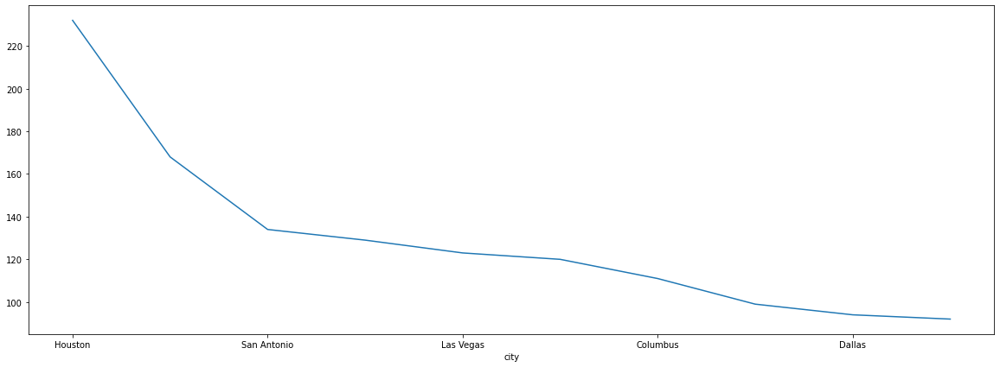

In [17]:
# Show in the graph

h_city.plot(figsize=(20,7))


## Summary 
### The highest branch [ " State & City " ] at USA

#### The highest branch at the State
- California = 2590
- Texas      = 2194

#### The highest branch at the City

-  Houston   = 232




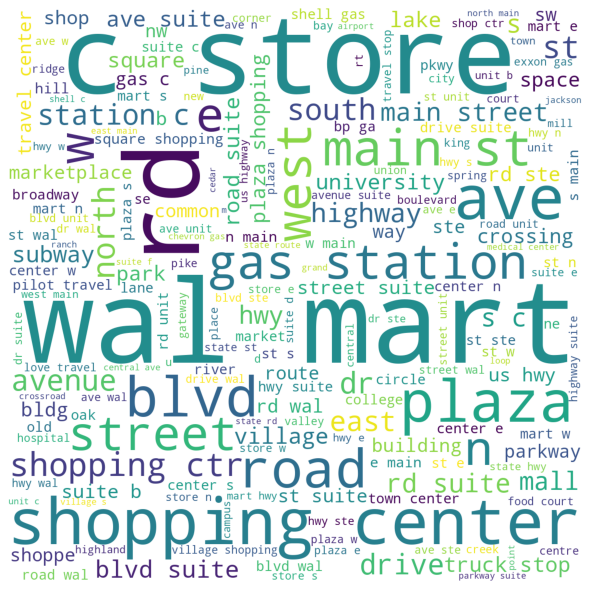

In [18]:
# The more frequent street address


comment_words = ''
stopwords = set(STOPWORDS)

# iterate through the csv file
for val in data.street_address:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 1200, height = 1200,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

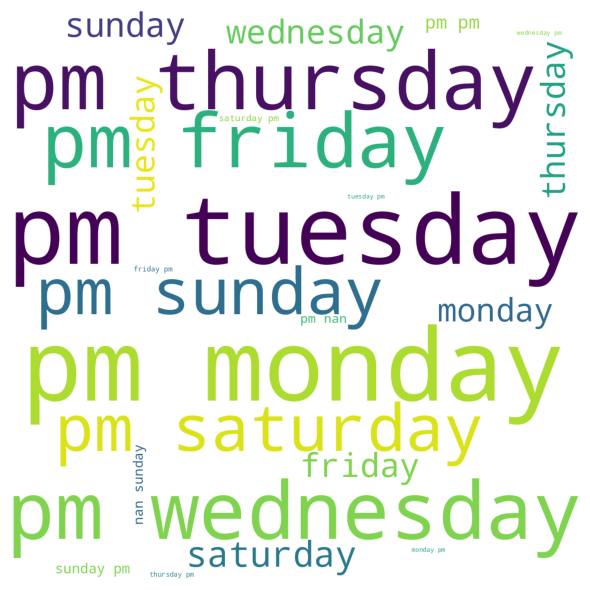

In [19]:
# The more frequent open hours

comment_words = ''
stopwords = set(STOPWORDS)

# iterate through the csv file
for val in data.open_hours:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 1200, height = 1200,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

### Now let`s make map using - "latitude","longitude"

In [20]:
# the map

sanfran_map = folium.Map(location=[56.130, -106.35], zoom_start=8)

# display world map
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, in zip(data.latitude, data.longitude):
    incidents.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=5, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add incidents to map
sanfran_map.add_child(incidents)

## Thanks for reading my analysis .